# Craft Beer Ratings

In [1]:
%autosave 0

Autosave disabled


In [3]:
%matplotlib inline
import string
from  collections import Counter
import pandas as pd
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import psycopg2
import seaborn as sbn
from altair import Chart, X, Y, Color, Scale
import altair as alt
import requests
import nltk
from nltk.corpus import stopwords 
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression, LogisticRegression
from sklearn.metrics import accuracy_score
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from graphviz import Digraph

matplotlib.style.use('ggplot')


## Reading List

* Reshaping data
* [Linear Regression](https://medium.com/@amarbudhiraja/ml-101-linear-regression-tutorial-1e40e29f1934)
* Mulitple Regression
* Logistic Regression
* Sentiment Analysis and NLTK

## Exploratory Questions


1. Is the data complete?  What data is missing and how much?
1. what is the highest/lowest rated beer? (based on the average of all of its ratings)
1. What is the distribution of the overall beer ratings?
1. Are there styles of beers that tend to get higher ratings than others?
1. Does the ABV values for beer correlate with any of the reviews / rankings?
1. What is the breakdown of gender for the reviewers?
1. Do any of the styles of beers appeal more to one gender or the other?
1. Show all the beers from the brewer with the highest average rating
1. Is the taste rating a good predictor for the overall rating?
1. If we simplify the problem to a thumbs-up versus thumbs-down rating can we predict better?

## Research Question (Kaggle contest)

1. Can we use the textual review of to predict an overall rating for the beer?

This is a great research question for us because there is a lot of freedom to process the text reviews in any way we want/can in order to make the best ratings possible.

In [4]:
bf = pd.read_csv('Data/beer_train.csv')

In [5]:
bf.head()

,index,beer/ABV,beer/beerId,beer/brewerId,beer/name,beer/style,review/appearance,review/aroma,review/overall,review/palate,review/taste,review/text,review/timeStruct,review/timeUnix,user/ageInSeconds,user/birthdayRaw,user/birthdayUnix,user/gender,user/profileName
0,40163,5.0,46634,14338,Chiostro,Herbed / Spiced Beer,4.0,4.0,4.0,4.0,4.0,Pours a clouded gold with a thin white head. N...,"{'min': 38, 'hour': 3, 'mday': 16, 'sec': 10, ...",1229398690,NaN,NaN,NaN,NaN,RblWthACoz
1,8135,11.0,3003,395,Bearded Pat's Barleywine,American Barleywine,4.0,3.5,3.5,3.5,3.0,12oz bottle into 8oz snifter.\t\tDeep ruby red...,"{'min': 38, 'hour': 23, 'mday': 8, 'sec': 58, ...",1218238738,NaN,NaN,NaN,NaN,BeerSox
2,10529,4.7,961,365,Naughty Nellie's Ale,American Pale Ale (APA),3.5,4.0,3.5,3.5,3.5,First enjoyed at the brewpub about 2 years ago...,"{'min': 7, 'hour': 18, 'mday': 26, 'sec': 2, '...",1101492422,NaN,NaN,NaN,Male,mschofield
3,44610,4.4,429,1,Pilsner Urquell,Czech Pilsener,3.0,3.0,2.5,3.0,3.0,First thing I noticed after pouring from green...,"{'min': 7, 'hour': 1, 'mday': 20, 'sec': 5, 'y...",1308532025,1.209827e+09,"Aug 10, 1976",208508400.0,Male,molegar76
4,37062,4.4,4904,1417,Black Sheep Ale (Special),English Pale Ale,4.0,3.0,3.0,3.5,2.5,A: pours an amber with a one finger head but o...,"{'min': 51, 'hour': 6, 'mday': 12, 'sec': 48, ...",1299912708,NaN,NaN,NaN,NaN,Brewbro000


### Checking for missing data

The easiest way to check for missing data in pandas is to use the `isna` method on the dataframe.  Used alone this gives you a giant table of True/False values depending on whether a particular cell in the dataframe has a value. We are interested in knowing if any of our columns have missing values and we can use the any function to reduce the big matrix into a table of columns.  

In [6]:
bf.isna().any(axis=0)

index                False
beer/ABV             False
beer/beerId          False
beer/brewerId        False
beer/name            False
beer/style           False
review/appearance    False
review/aroma         False
review/overall       False
review/palate        False
review/taste         False
review/text           True
review/timeStruct    False
review/timeUnix      False
user/ageInSeconds     True
user/birthdayRaw      True
user/birthdayUnix     True
user/gender           True
user/profileName      True
dtype: bool

In [7]:
print("total len = ", len(bf))
print("missing: ", len(bf[bf['user/gender'].isna() == True]))

total len =  37500
missing:  22186


## Distribution of ratings

To get a sense for the overall distribution of ratings of the beer.

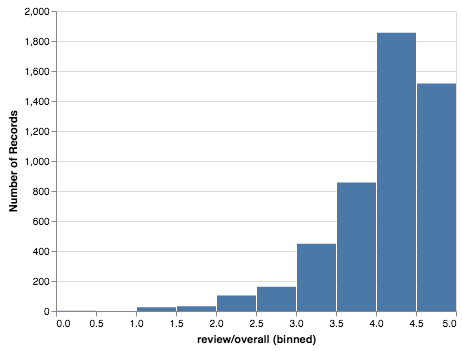

In [8]:
alt.Chart(bf[['review/overall']].sample(5000)).mark_bar().encode(alt.X('review/overall', bin=True), alt.Y('count()'))


## What are the Highest / Lowest rated beers according to their mean overall rating

For this question we want to group the beer by their id (some beers from different brewers **do** have the same name so we use the id to be sure that we are getting the ratings only for a particular beer.


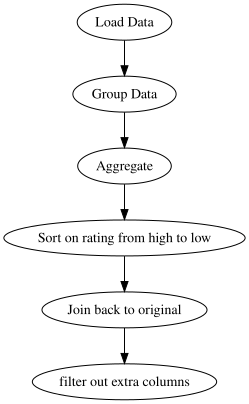

In [9]:

dot = Digraph(comment='The Round Table')

dot.node('A', 'Load Data')
dot.node('B', 'Group Data')
dot.node('L', 'Aggregate')
dot.node('S', 'Sort on rating from high to low')
dot.node('J', 'Join back to original')
dot.node('F', 'filter out extra columns')
dot.edges(['AB', 'BL', 'LS', 'SJ', 'JF'])

dot

In [10]:
byid = bf.groupby('beer/beerId')[['review/overall']].mean().sort_values(['review/overall'], ascending=False)
byid.merge(bf[['beer/beerId', 'beer/name', 'beer/style']], left_index=True, right_on='beer/beerId').head(10)


,review/overall,beer/beerId,beer/name,beer/style
10640,5.0,77207,Black IPA,American Black Ale
16450,5.0,75449,Centennial Pale Ale,American Pale Ale (APA)
8273,5.0,32283,Chocolate Nutter,English Stout
26147,5.0,72118,Bourbon Barrel Coffee Night Train,American Porter
4719,5.0,72007,Saisonnaire,Saison / Farmhouse Ale
17628,5.0,40448,BourbonDog ESB,Extra Special / Strong Bitter (ESB)
25797,5.0,63460,Limping Mallard,English Strong Ale
25082,5.0,55601,Suicide By Hops,American IPA
28518,5.0,44081,Gene's American Brown Ale,American Brown Ale
11379,5.0,64487,Bigwood Oak Aged Stout,American Double / Imperial Stout


That looks a bit complicated but its not really too bad if you break it down.

    Group = bf.groupby('beer/beerId')[['review/overall']]
    Aggregate = Group.mean()
    Sort = Aggregate.sort_values('review/overall', ascending=False)
    Join = byid.merge(bf[['beer/beerId', 'beer/name', 'beer/style']], left_index=True, right_on='beer/beerId').head(10)



### Practice Questions

1. What are the 10 lowest rated beers?
1. Like any recommendation system its hard to judge just based on a single number.  Its important to know how many ratings that number was based on.  If its just one person rating something a 5 thats a lot less impressive than 5000 people rating it a 5.  Add a column to the above chart that shows the number of ratings.
1. This might also make you wonder about the other ratings.  What are the 10 best beers by taste?  Are they the same 10 as for the overall?
2. What are the 10 best beers according to women?
3. What are the 10 best beers according to men?

## Exploring beer styles a bit

How many different unique styles are there?

In [11]:
bf['beer/style'].unique()

array(['Herbed / Spiced Beer', 'American Barleywine',
       'American Pale Ale (APA)', 'Czech Pilsener', 'English Pale Ale',
       'Russian Imperial Stout', 'American Wild Ale', 'Pumpkin Ale',
       'English Barleywine', 'American IPA', 'Scotch Ale / Wee Heavy',
       'American Double / Imperial Stout', 'Euro Pale Lager',
       'Maibock / Helles Bock', 'American Amber / Red Ale', 'Rye Beer',
       'American Double / Imperial IPA', 'MÃ¤rzen / Oktoberfest',
       'Fruit / Vegetable Beer', 'Witbier', 'Light Lager', 'Rauchbier',
       'American Porter', 'Hefeweizen',
       'Extra Special / Strong Bitter (ESB)', 'Wheatwine',
       'English Strong Ale', 'Braggot', 'Euro Strong Lager',
       'Munich Helles Lager', 'English India Pale Ale (IPA)', 'Altbier',
       'Doppelbock', 'American Brown Ale', 'Munich Dunkel Lager',
       'Irish Dry Stout', 'KÃ¶lsch', 'Foreign / Export Stout',
       'Cream Ale', 'Lambic - Unblended', 'Scottish Ale', 'Baltic Porter',
       'Belgian IPA', 'Ol

### What are the highest rated styles?

In [12]:
bf.groupby('beer/style')['review/overall'].agg(['mean','count']).sort_values('mean', ascending=False).head(10)


,mean,count
beer/style,,
American Double / Imperial Stout,4.326919,4495
English Barleywine,4.233333,90
Keller Bier / Zwickel Bier,4.184211,19
Russian Imperial Stout,4.168061,2032
Rye Beer,4.162362,1355
Munich Helles Lager,4.096115,489
English Dark Mild Ale,4.062500,16
Baltic Porter,4.047030,404
American IPA,4.045082,3050


## Looking for Correlations in the data?

A scatter plot is a graph we often turn to when we are looking to see if there is some kind of correlation between two variables.  Lets do a quick scatter plot to see if a users taste rating is correlated with their overall review of the beer.

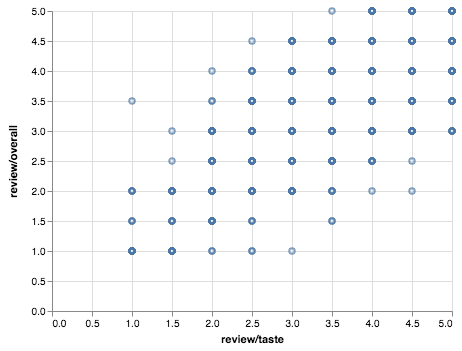

In [13]:
alt.Chart(bf.sample(5000)).mark_point().encode(y='review/overall',x='review/taste')

Well, that is not very satisfying.  All the points ona a grid so its pretty hard to tell whats going on.  The problem is that the ratings are all on a 0 to 5 star scale with half-stars allowed.  The color gives us a bit of a hint about how many times the taste and overall rating were both 4.0 but it isn't very conclusive in terms of telling us anything about correlation.

We can improve our view a lot by using a 'bubble plot' instead of a scatter plot.  A bubble plot is really just a variation of the scatter plot where we make the size of the circle proportional to something in the data.  In this case we will make the size of the circle proportional to the number of points that share the same coordinates.  While we are at it we will also make the color of the circle correspond to the gender of the reviewer to give us a sense for any differences between males and females and their preferences.

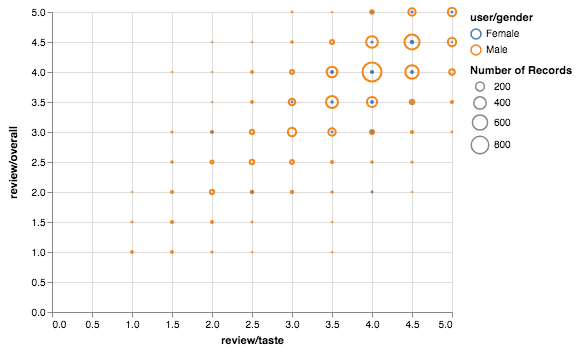

In [14]:
alt.Chart(bf[bf['user/gender'].isna() == False].sample(5000)).mark_point().encode(y='review/overall',x='review/taste', size='count()', color='user/gender:N')

Nice!  That gives us a much better picture and would lead us to believe that there is some correlation between taste and the overall rating.  That makes sense.  You should try to build a similar graph to see about the palate or the appearance as well.  It raises some interesting questions about the number of male and female reviewers and whether the tastes of the male reviewers are correllated.  It looks like there are a lot fewer females by the size of the bubble.  Can you think of another way of sizing the bubbles that might better represent  this data and male/female differences besides the raw count of ratings?

In fact we are interested in seeing what kind of correlation exists between all of these numeric variables.  To do that we can use the `corr` function of pandas to build a matrix that shows the correlation between each pair of variables.

In [15]:
cm = bf[['review/appearance','review/overall','review/palate', 'review/taste', 'beer/ABV']].corr()
cm

,review/appearance,review/overall,review/palate,review/taste,beer/ABV
review/appearance,1.000000,0.498733,0.555833,0.531676,0.288376
review/overall,0.498733,1.000000,0.697220,0.785220,0.197005
review/palate,0.555833,0.697220,1.000000,0.732092,0.350656
review/taste,0.531676,0.785220,0.732092,1.000000,0.354033
beer/ABV,0.288376,0.197005,0.350656,0.354033,1.000000


## Visualizing Correlation with a HeatMap

Although the table above is nice, its hard tos ee if there are obvious patterns or hotspots in the list of correlations, this is where a heatmap can be very useful.  it will give us a graphical representation of the correlation matrix where the bright spots on the graph correspond to the largest correlations.

Lots of graphing packages support the building of a heat map, and this is a good example because it shows that very often we need to do a little bit of reshaping of our data before we let the graphing software do its thing.  In this case we have a table of correlations, but the graph is in "wide format" that is a separate column and row heading for each attribute.  Most graphing packages like to have the data in a "tidy" format or a narrow format.  Where we have think about the data as the coordinates into the table ("appearance", "taste") gives us the correlation value between appearance and tast, where as (taste, overall ) gives us the correlation between  taste and overall.  We can represent this in a tidy format with three columns, lets call them index, attribute and corr.

How can we quickly and easily convert our data from the table format above to the tidy format we need?  This is a great example of when to use pandas ``melt`` function.  In the last project we looked at making a pivot table from the data, the melt function does the opposite of pivot.  It takes several columns and makes them values in a single column then stores the values that would ordinarily be in a particular cell of a table and puts the in the row with the coordinates as columns.

In [16]:
cm.reset_index(inplace=True)
cm = cm.melt(id_vars='index', value_vars=['review/appearance','review/overall','review/palate', 'review/taste', 'beer/ABV'],  value_name='corr', var_name='attribute')


In [17]:
cm.head()

,index,attribute,corr
0,review/appearance,review/appearance,1.000000
1,review/overall,review/appearance,0.498733
2,review/palate,review/appearance,0.555833
3,review/taste,review/appearance,0.531676
4,beer/ABV,review/appearance,0.288376


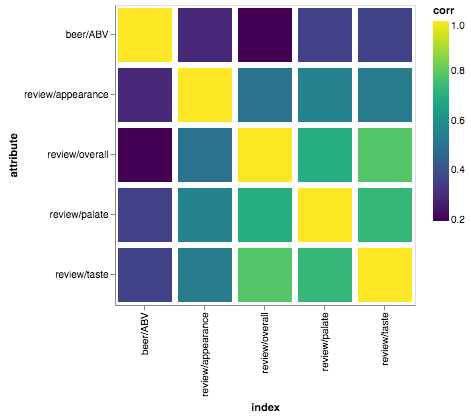

In [18]:
alt.Chart(cm,height=300, width=300).mark_rect().encode(x='index',y='attribute',color='corr',tooltip='corr')
# The default size makes the graph smaller than the legend and it lookks rather odd. specifying height and width improves the aesthetics

## Linear Regression for predicting overall rating

Based on the above data, we want to test the question "can we predict a users overall rating for a beer if we know their rating of taste?"  If you don't remember anything about linear regression you can get a handy review [here](https://medium.com/@amarbudhiraja/ml-101-linear-regression-tutorial-1e40e29f1934)

Try a regression using just taste

1. Split the data into training and test
2. train the model
    1. training tries to find the coefficient that minimizes the MSE
    2. Lets look at that in Google Sheets with Solver
    3. Lets take our first look at scikit-learn

3. make predictions on the test
4. calculate the error.
    1. MAE
    1. MSE
    
5. Improving the model
    1. Use more variables such as appearance, pallete and ABV
    2. Normalize!

6. The real challenge is to use the text of the review.
    1. turning text into numeric data
    2. what to look for?
    3. What is one-hot encoding?
    
    

## Linear Regression with Scikit-Learn

Scikit-learn has an easy to use API that will allow us to train a model use that model to make predictions, and then look at results!  You don't have to understand any of the math behind the models that we will build, but it is really helpful for you to develop some intuition for when a certain kind of model is useful versus using a different model.

To show you how easy this is lets build a simple one variable Linear regression model that we know from our exploratory analysis of the data will work pretty well.  That is if we know the rating that a user made about the taste of the beer there was a .79 correlation with how they rated beer overall.  

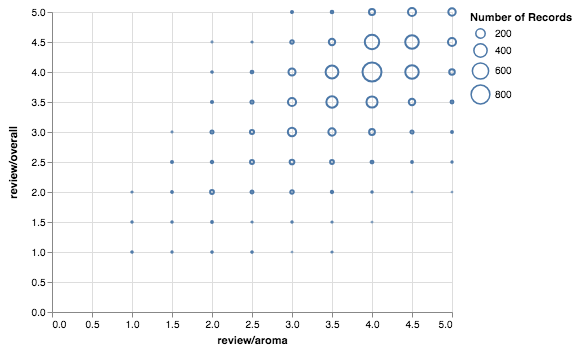

In [19]:
alt.Chart(bf.sample(5000)).mark_point().encode(y='review/overall',x='review/aroma', size='count()')

To test our hypothesis that the taste rating is a good predictor for the overall rating, we will build a linear regression model.  Just like we did in AC101 with the Pizza data where we used the diameter of the pizza as a predictor for the cost of the pizza.

To be a little more scientific about this we will split our data into a "training set" that we will use to build the model, and a "test set" that we will use to validate the model.  That is we want to test our model on data that is different from the data we used to build the model.  Testing using the data the you trained on would be like cheating as you could just build a model the memorized everything and got 100% but in the real world you need to make predictions for things that you have not seen before.  

The first thing we'll do create two simplified dataframes one that contains a column containing the taste rating for each beer and a second column that contains the overall rating.  Next we'll randomly select 80% of the data to use in creating our linear regression model, and 20% of the data to use in testing.  scikit learn gives us a handy function that does all of that for us.  We'll end up with four data frames:

* train_X, train_y - this is the data we'll use to create our model.  Remember that in linear regression we are trying to come up with a slope and intercept value that minimize the error, so we need to know the answer.

* test_X - we will use this data (without train_y) to make predictions given a rating from test_X we'll use our model to caculate a predicted overall value.

* test_y - we will use this data along with the predicted values to come up with our score.  The score we calculate will be the mean absolute error.



In [20]:
beer_X = bf[['review/taste']]
beer_y = bf[['review/overall']]
train_X, test_X, train_y, test_y = train_test_split(beer_X, beer_y, random_state=42)

Take a few moments to inspect the variables ``train_X, test_X, train_y and test_y``


Createing a Linear Regression model is easy.  We just instantiate a new model and then fit our data using the train_X and train_y data.  The fit process does what you reviewed above. It finds the slope and intercept that minimize the error.  But only for the training data!  The real test comes when we see how well this slope and intercept work for our test data.

In [21]:
rmodel = LinearRegression()
rmodel.fit(train_X.values, train_y.values)

/Users/bradleymiller/.local/share/virtualenvs/httlads--V2x4wK-/lib/python3.6/site-packages/sklearn/linear_model/base.py:485: RuntimeWarning: internal gelsd driver lwork query error, required iwork dimension not returned. This is likely the result of LAPACK bug 0038, fixed in LAPACK 3.2.2 (released July 21, 2010). Falling back to 'gelss' driver.
  linalg.lstsq(X, y)


LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None,
         normalize=False)

Now using the ``test_X`` values from the test data set we will use the values for slope and intercept calculated when we fit the model to predict new y values (our predicted values for the over ratings on our test beers)  This is a good test because we haven't looked at this data when we were fitting our model and so it is much more like making a prediction in real life.

In [22]:
preds = rmodel.predict(test_X)

In [23]:
preds[:20]

array([[3.94899141],
       [3.56469971],
       [2.02753292],
       [4.33328311],
       [3.18040802],
       [3.56469971],
       [4.33328311],
       [4.33328311],
       [3.56469971],
       [3.18040802],
       [4.33328311],
       [3.18040802],
       [3.56469971],
       [4.71757481],
       [4.33328311],
       [3.94899141],
       [4.33328311],
       [2.02753292],
       [4.33328311],
       [3.56469971]])

### Measuring Error

Now lets talk about error!  How do we judge how well our model works?

There are two primary (and easy) metrics that we can use at this point

1. Mean Squared Error (MSE) is the average of taking the prediction minus the real ratings and then squaring the result.  Why do we square it?  So that each of the values is positive.  If we had some predicitions too high and some too low then they tend to cancel each other out, squaring them makes sure that does not happen.  The problem with this measure is that the units are squared so it doesn't give us as measure that maps directly to the thing we are trying to predict.  We can fix this by taking the squre root of the result and this is often referred to as the Root Mean Squared Error or RMSE.  The advantage of the MSE is that squaring works better with some learning algorithms than taking the absolute value.

2. Mean Absolute Error (MAE) is the average of the absolute value of the difference between the predicted and the real value.

In [24]:
from sklearn.metrics import mean_absolute_error, mean_squared_error

print("MAE = ", mean_absolute_error(test_y, preds))
print("MSE = ", mean_squared_error(test_y, preds))


MAE =  0.32599687200504984
MSE =  0.18649948721779958


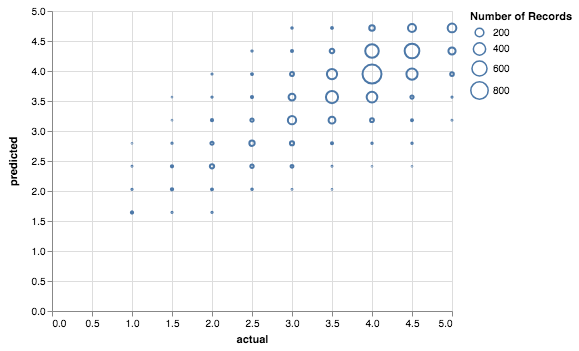

In [25]:
alt.Chart(pd.DataFrame({'actual': test_y['review/overall'].values[:5000], 'predicted':preds.ravel()[:5000]})).mark_point().encode(x='actual',y='predicted',size='count()')

Let us compare the distribution of the predictions


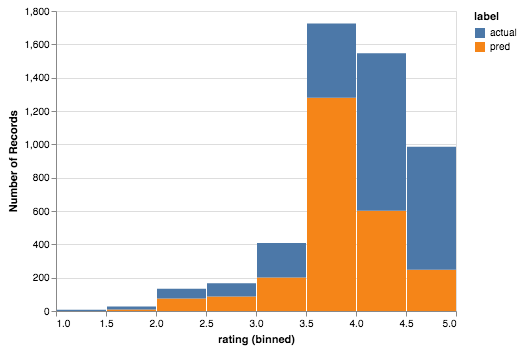

In [26]:
alt.Chart(pd.DataFrame({'rating': np.concatenate((preds.ravel()[:2500], test_y['review/overall'].values[:2500])), 
                        'label':['pred']*2500 + ['actual']*2500 })).mark_bar().encode(
    x=alt.X('rating', bin=True), y='count()', color='label')

So you can see that the predictions tend to underpredict the actual rating by a bit.  The predictor makes a lot more predictions in the 3.5 to 4.0 range than there are actual ratings and the predictor predicts far fewer rathings in the 4.5 to 5 range than actual.

In [27]:
train_y['review/overall'].mean()

3.888871111111111

In [28]:
len(preds)

9375

In [29]:
avg_preds = np.full(9373, train_y['review/overall'].mean())

In [30]:
abs(avg_preds-test_y.values).mean()

0.522489222637008

So, the good news is that our linear regression does better than just predicting the average.  Can we do better with more data?  What if we include the review/pallete and review/appearance as part of the training data?


In [31]:
beer_X = bf[['review/taste', 'review/palate', 'review/appearance']]
beer_y = bf[['review/overall']]
train_X, test_X, train_y, test_y = train_test_split(beer_X, beer_y, random_state=42)

In [32]:
rmodel = LinearRegression()
rmodel.fit(train_X.values, train_y.values)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None,
         normalize=False)

In [33]:
preds = rmodel.predict(test_X)

In [34]:
abs(preds-test_y.values).mean()

0.30952150457163924

Thats a little better .30 is a bit smaller error than .32.

We do have more data that we could try to exploit.

1. We know the ABV (Alchohol By Volume) for each beer.  We could use that easily as it is another numeric field.
2. We have some information about the reviewers, but as we saw from our earlier analysis we are missing 70 percent of it.  
3. We have the text of the review, which if we were reading them ourselves would give us a very good indication of whether the review was going to be positive or negative.

Strategies 1 and 3 are the most interesting and each will introduce some important machine learning concepts so lets take a look.

1. If we add the ABV value we can see that it is on a different scale than our various user entered ratings.  So its a good idea to rescale the data. so it is on a scale from -1 to 1  where the mean of the data is moved to 0 (StandardScaler) or just 0 to 1 (MinMaxScaler).

As a baseline lets add in the ABV value without doing any rescaling to see what our error looks like.  Then we will rescale and try again to see if we really get any improvement.

## Rescaling and using ABV

In [35]:
beer_X = bf[['review/taste', 'review/palate', 'review/appearance', 'beer/ABV']]
beer_y = bf[['review/overall']]
train_X, test_X, train_y, test_y = train_test_split(beer_X, beer_y, random_state=42)

In [36]:
rmodel = LinearRegression()
rmodel.fit(train_X.values, train_y.values)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None,
         normalize=False)

In [37]:
preds = rmodel.predict(test_X)

In [38]:
abs(preds-test_y.values).mean()

0.30576431129937715

Adding in the ABV gives us a slight edge.  Lets see if rescaling helps even more.

In [39]:
scaler = StandardScaler()
scaled_X = scaler.fit_transform(beer_X)

In [40]:
train_X, test_X, train_y, test_y = train_test_split(scaled_X, beer_y, random_state=42)

In [41]:
rmodel = LinearRegression()
rmodel.fit(train_X, train_y.values)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None,
         normalize=False)

In [42]:
preds = rmodel.predict(test_X)

In [43]:
abs(preds-test_y.values).mean()

0.3057643112993791

In [44]:
np.sqrt(((preds-test_y) ** 2.0).mean())

review/overall    0.403833
dtype: float64

OK, so that didn't help at all (It didn't hurt either) in this case.  The statistics below show that 75% of the values for ABV are betwen 0 and 9.4 which is not too far off from our 0 to 5 rating scale.

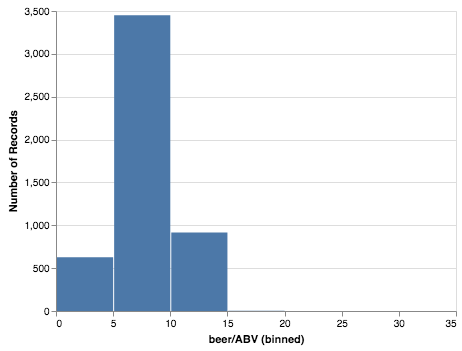

In [45]:
alt.Chart(bf.sample(5000)).mark_bar().encode(alt.X('beer/ABV', bin=True), y='count()')

In [46]:
bf['beer/ABV'].describe()

count    37500.000000
mean         7.403725
std          2.318145
min          0.100000
25%          5.400000
50%          6.900000
75%          9.400000
max         57.700000
Name: beer/ABV, dtype: float64

## Exercise -- Simplify the problem

One way that we could potentially make this easier on ourselves would be to reduce the ratings to a thumbs up or thumbs down, 0 or 1 rating.  We could introduce a threshold value and convert all of the rating/overall values to either 0 or 1 then we have only two values to try to predict.  What we are really doing now is trying to classify the beer as a 'good beer' or a 'bad beer'.  This will change our measure of success too.

You will need to do the following steps:

1. transform the rating/overall values to 0 or 1 (you decide the threshold and give some justification)
2. remake the training and test data
3. retrain and test the model

How did you do?  Now remember if you are off by .3 now that is much much worse than before as you are trying to predict between 0 and 1 rather than 0 and 5

Make a graph of the distribution of your predictions.

What if we could change that distribution to look more like the red bars in this graph.

<img src='compare_bars.png'>

One way to get there would be to modify all of your predicted values to be either 0 or 1 based on a threshold.  With some trial and error at picking the threshold you might get really good results.  In fact there is a graph called an ROC curve that will help you pick that threshold.  But We will leave that as an advanced research project.

For now we will use a slightly different kind of regression algorithm called logistic regression.  Its called this because it applys a logistic function to the predicted values during the training cycle.  The function has the property that it forces all of the values toward 0 and 1 anything less than 0 becomes 0 and anything more than 1 becomes 1.  But... because this happens during the training cycle the all of our values are going to end up very close to 0 or 1 just like the red bars in the graph above.  But we don't have to figure out the best threshold.

Let us see how easy it is to train a LogisticRegression model using scikit learn!

In [47]:
# start by converting everything to a thumbs up / thumbs down rating.
bf['thumbs'] = bf['review/overall'].map(lambda x : 1 if x >= 3.5 else 0)

In [48]:
beer_X = bf[['review/taste', 'review/palate', 'review/appearance', 'beer/ABV']]
beer_y = bf[['thumbs']]
train_X, test_X, train_y, test_y = train_test_split(beer_X, beer_y, random_state=42)

Now instead of ``LinearRegression`` we use ``LogisticRegression`` 

In [49]:
rmodel = LogisticRegression(solver='lbfgs')
rmodel.fit(train_X.values, train_y.values.ravel())

LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
          intercept_scaling=1, max_iter=100, multi_class='warn',
          n_jobs=None, penalty='l2', random_state=None, solver='lbfgs',
          tol=0.0001, verbose=0, warm_start=False)

In [50]:
preds = rmodel.predict(test_X)

In [51]:
mean_absolute_error(test_y, preds)

0.07818666666666667

OH NO!! Our error value looks horrible!  Whats going on?  


Don't panic.  Lets look at the distribution of our predictions and see if that gives us some insight.

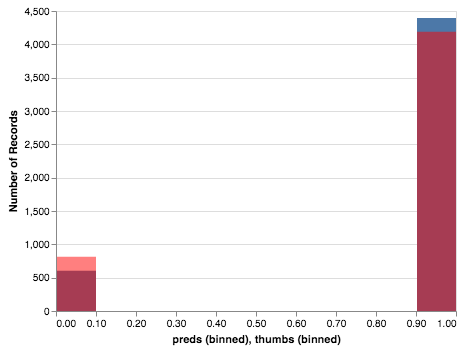

In [52]:
alt.Chart(pd.DataFrame({'preds':preds.ravel()[:5000]})).mark_bar().encode(alt.X('preds',bin=True), y='count()') + \
alt.Chart(bf.sample(5000)).mark_bar(color='red',opacity=0.5).encode(alt.X('thumbs',bin=True),y='count()')

It looks like we are slightly underpredicting thumbs down but slightly overpredicting thumbs up.  But the distance of the errors is now much worse we are off by 1 when we are wrong.  But how many values are we off by nearly 1 on?

When we are doing a **classification problem** we can use the accuracy score function of scikit learn to tell us the fraction of the time we are correct.  In this case it is not too bad at 92% thats a solid A- anyway.

In [53]:
accuracy_score(test_y, preds)

0.9218133333333334

# Exploratory analysis of the review text

1. What is the average length of the review text?
1. How many unique words are included in all of the reviews?
1. On average, which are longer, positive reviews or negative reviews?
1. Excluding the normal stopwords, which are the most common words used across all reviews.
1. Remove the 25 most common beer stopwords from these reviews.
1. Are there differences in the most common words used by men and women?
1. What are the most common words used to describe good beers?   bad beers?
1. What words are used to describe good beers but not bad beers?
1. What words are used to describe bad beers but not good beers?


### Cleaning up the review Text

As we have done before, let's clean up the review text by:

* Convert everything to lower case
* Remove all punctuation
* split the text into a list of words
* Remove the rows where there is no review text

In [54]:
bf['review/text'] = bf['review/text'].str.lower()

In [55]:
bf.loc[:5,'review/text']

0    pours a clouded gold with a thin white head. n...
1    12oz bottle into 8oz snifter.\t\tdeep ruby red...
2    first enjoyed at the brewpub about 2 years ago...
3    first thing i noticed after pouring from green...
4    a: pours an amber with a one finger head but o...
5    served in a snifter; on-tap at cbc.\t\tcolor i...
Name: review/text, dtype: object

In [56]:
import string
bf['review/text'] = bf['review/text'].str.translate(str.maketrans(string.punctuation, ' '*len(string.punctuation)))


In [57]:
bf['text_list'] = bf['review/text'].str.split()

In [58]:
bf.dropna(subset=['review/text'], inplace=True)

In [59]:
c = Counter()

tl = 0
for row in bf.text_list:
    c.update(row)
    tl += len(row)

print('total number of words ', tl)
print('unique words = ', len(c.keys()))

total number of words  4897852
unique words =  41375


In [60]:
sw = set(stopwords.words('english'))

In [61]:
for w in sw:
    del c[w]

In [65]:
ll = 0
for w in c:
    if c[w] < 50:
        ll += 1

ll

37658

In [66]:
len(c) - ll

3567

# A harder problem -- Use the text and any other data you can find to predict review/overall or review/taste

Now for the curveball. You are **not allowed to use any of the review data** in your model.  Only the ABV and whatever you can make out of the review/text field.

1. Go back to trying to make a prediction between 0 and 5
2. build a LinearRegression model using only ABV how well does that work?
3. Next we need to convert what we can find in the review/text column into some numerical values.  There are a few  avenues you might try:
    1. Add columns for **every** unique word used across all reviews.  For a particular row in the table the value will be 1 if the word was used in this review and 0 if it was not.  This is a technique known as **1 hot** encoding.
    1. Convert the whole text to a score based on how positive or negative it seems (sounds like sentiment analysis)
    2. Add columns for a "bunch" of key words that appear in reviews for examply hoppy or bitter if the review contains the word then that column gets a 1 for that review if it does not then it gets a 0.  You might end up adding 25 or 30 columns like this.  Some of the columns might represent words like 'horrible' or 'terrific' or 'dark' or 'creamy'.  

The challenge is to see how low you can make your MAE using only this data.  You could also try this using the thumbs up and thumbs down approach and see if you can beat our .92 score.

This is the problem posed on a real life Kaggle competition.  If you can get better than a .57 Root Mean Squared Error then you would have made the top 7 and been on the leaderboard.  If you can do better than .63 then your instructor better give you an A for this exercise because that is better than I did.

## Lets try A together

There are 41,375 unique words used across all of the beer reviews.  If we eliminate the stopwords and all of the words that are used less than 50 times we will be left with about 3,700 words.  Why did we choose 50?  I originally tried 10 and got 8,725 words and it took my macbook pro over 2 hours to run the regression! It also turned out that fewere words was better. 3700 is still a lot of columns, but scikit learn doesn't care how many columns we have so we might as well start there.  

**Note** this is a good example of where Data Science is part science and part art/guessing/work.

### One-Hot encoding all the words

For each of the words in our list of unique words we want to add a column.  And for each of the rows in the data frame we want to see if the word corresponding to the column is in the text.

First lets remove all of the words used less than 50 times.

In [67]:
remove_list = []
for w in c:
    if c[w] < 50:
        remove_list.append(w)

for w in remove_list:
    del c[w]

len(c)


3567

Now for each of the words that remain we will make a column and either a 0 or 1 in each row for this new column.

Using a for loop and a map we can do this in just two lines!  Do you feel powerful?  This will take a while so when you run the next cell you can get a coffee.


In [68]:
for w in c.keys():
    bf[w] = bf.text_list.map(lambda x : 1 if w in x else 0)
    
    

OK, now lets prepare our data for testing.  We will need the following:

1. One dataframe with only the 1-hot encoded words
2. One dataframe with the overall ratings

Then we can use the train test split utility as usual to create our training and test data



In [69]:
worddf = bf[list(c.keys())]
ratings = bf['review/overall']
train_X, test_X, train_y, test_y = train_test_split(worddf, ratings)

In [70]:
%%time

model = LinearRegression(n_jobs=-1)
model.fit(train_X, train_y)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None,
         normalize=False)

In [71]:
preds = model.predict(test_X)

Well, that took a while!  Even on a nice new macbook pro that took around 2.5 hours to train.  Of course thats nothing compared to some commercial models that run on thousands of CPU's for days at a time.  Its also a good starting point to think about the tradeoffs between the amount of data required, the amount of CPU time required and the cost of that CPU time, memory, and the productivity of the data scientist that has to sit around and wait for the model to build.

How did we do?

In [72]:
mean_absolute_error(test_y, preds)

0.4282070966217883

Not very good, on average we are basically 0.5 over or 0.5 under.  Lets take a look at the distribution of the predictions using this strategy.

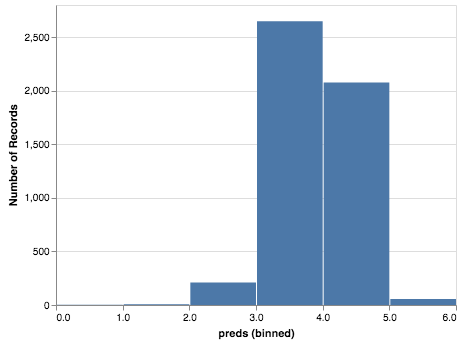

In [73]:
alt.Chart(pd.DataFrame({'preds':preds[:5000]})).mark_bar().encode(alt.X('preds:Q', bin=True),y='count()')

This is a good lesson for us all.  **More Data** does not always mean better results.

One thing this is often useful to do is to dig into the results more closely to try to understand the cases where we were close and the cases where we were far away on our predictions.  We can also inspect our model more closely to see if we can learn anything from the model and how it weighted the presence of various words.

In this model Linear Regression makes its prediction using a formula that looks like this $prediction = \theta_1 word_1 + \theta_2 word_2 + \theta_3 word_3 + ... + \theta_n word_n + b$  So one interesting thing to do would be to look at the $\theta$ values along with their words and inspect the words with the largest and smallest $\theta$ values.

We can get the $\theta$ values from the model's `coef_` attribute

In [74]:
model.coef_[:20].tolist()

[-0.0074454078629078045,
 0.00886595002746672,
 0.002743127781573309,
 -0.01990586035054493,
 -0.03044202616798666,
 0.008853538098667405,
 0.005382610010844407,
 -0.012988143282461881,
 0.018637704470198416,
 0.07143940825478153,
 0.03260856408659432,
 0.028785243984702915,
 -0.024495416737082658,
 0.0023586953921986144,
 -0.009865281456728566,
 0.03227525658917331,
 0.06344450100317604,
 -0.009831667009395468,
 -0.07773376898818124,
 -0.022883430765384058]

The order of the weights in the coef variable line up with the order of the columns in our model.  So it makes it easy for us to match them up.  We don't even have to write a loop for this because we can use Python's [zip](https://docs.python.org/3/library/functions.html#zip) function to do the job for us.

In [75]:
weight_words = zip(train_X.columns.tolist(), model.coef_.tolist())
#list(weight_words)[:10]

In [76]:
from operator import itemgetter
get_firsti = itemgetter(1)

In [77]:
sorted_weights = sorted(list(weight_words), key=lambda x: x[1], reverse=True)


In [78]:
sorted_weights[:10]

[('python', 0.34356728172616896),
 ('cashews', 0.31330384663214633),
 ('football', 0.30153734207782307),
 ('glorious', 0.2976152237006101),
 ('ratings', 0.29108775407461535),
 ('blond', 0.2882151398528475),
 ('sierra', 0.271511039366281),
 ('pilseners', 0.26374304258893433),
 ('dancing', 0.25626818124373335),
 ('blows', 0.2539178178822413)]

In [79]:
sorted_weights[-10:]

[('suffers', -0.3493507799151964),
 ('terrible', -0.3656588260674143),
 ('spoiled', -0.39039328380773214),
 ('nasty', -0.39458581901503775),
 ('infected', -0.4732998031430568),
 ('worst', -0.5046483549819343),
 ('chemical', -0.5626147636315543),
 ('undrinkable', -0.6556049241167169),
 ('awful', -0.6766767609197466),
 ('drain', -0.8068634090059008)]

The words with the larger positive coefficients don't necessarily look like they are useful in identifying good beers.  On the other hand the words with large negative coefficients like 'choke', 'drainpour',  and 'poo' would seem to be good candidates for describing bad beers.

Lets turn the word weight pairs into a dictionary and look at a few words

In [80]:
weight_word_dict = dict(sorted_weights)

In [81]:
for word in ['awesome', 'tasty', 'awful', 'delicious']:
    print(word, weight_word_dict[word])

awesome 0.09407585805097386
tasty 0.06446338718144483
awful -0.6766767609197466
delicious 0.12378698165327454


So words that we think would be associated with good beers have weights that are pretty close to zero, words taht we would associate with bad beers seem to have larger negative coefficients and we are wondering about the words at the top.  Lets look at the average rating of beers that contain the top 10 and bottom 10

This is a very interesting little puzzle in itself.  We want to select the rows from the bf dataframe where at least one of the words in the text of the review is in the list of either the top weights or the bottom weights.  Another way to think about this is to think of the review as a set of words and the top weights as a set of words.  What we want is where the interesection of those two sets contains at least one word.

Recall that selecting from a data frame involves creating a Series containing boolean values, the selction operation only returns the rows from the series that evaluate to True.  We often do this with some kind of direct comparison operator that results in a True / False series, but we can also create the series using `map`.

In [82]:
# create our sets
top_weights = set([x[0] for x in sorted_weights[:10]])
bottom_weights = set([x[0] for x in sorted_weights[-10:]])

In [83]:
bf[bf.text_list.map(lambda x:  len(set(x).intersection(top_weights)) > 0)]['review/overall'].mean()

4.0291734197730955

In [84]:
bf[bf.text_list.map(lambda x: not set(x).isdisjoint(top_weights))]['review/text'].head()

27     12oz stubby brown bottle  poured into a brandy...
116    i purchased this at a local beer superstore  t...
144    rbsg09 bottle at the grand tasting  pours a cl...
199    this was a very nice pilsner    very drinkable...
217    12 oz bottle with a very cool lime green label...
Name: review/text, dtype: object

In [85]:
bf[bf.text_list.map(lambda x:  len(set(x).intersection(bottom_weights)) > 0)]['review/overall'].mean()

2.855791962174941

Ok, at this point my hypothesis is that the predictions are getting really muddy because there are just too many words that appear in both good and bad.  Lets see if we can devalue the common words by turning the frequency count into a fraction.  Do do this we will sum up the count of all of the words and then divide each count by the total.


In [86]:
tot = sum(c.values(), 0.0)
for w in c:
    c[w] /= tot



In [87]:
c.most_common(10)

[('beer', 0.01842962398066282),
 ('head', 0.014268083382396433),
 ('taste', 0.010492145541404633),
 ('nice', 0.009644366429666174),
 ('like', 0.009145075321462602),
 ('good', 0.009043498100701312),
 ('malt', 0.008740719846509006),
 ('one', 0.008348866183341413),
 ('hops', 0.008280887581755013),
 ('sweet', 0.008232833742702556)]

In [88]:
c.most_common()[-10:]

[('scorched', 1.9534080915632694e-05),
 ('gingerbread', 1.9534080915632694e-05),
 ('specks', 1.9534080915632694e-05),
 ('stings', 1.9534080915632694e-05),
 ('friendly', 1.9534080915632694e-05),
 ('alley', 1.9534080915632694e-05),
 ('rule', 1.9534080915632694e-05),
 ('rubaeus', 1.9534080915632694e-05),
 ('display', 1.9534080915632694e-05),
 ('summit', 1.9534080915632694e-05)]

### Exercise:  Are Frequency and Weight correlated?


OK, before we move on let's try one little improvement.

In [89]:
for w in c.keys():
    bf[w] = bf.text_list.map(lambda x : 1/c[w] if w in x else 0)

bf.head()

,index,beer/ABV,beer/beerId,beer/brewerId,beer/name,beer/style,review/appearance,review/aroma,review/overall,review/palate,...,streaks,brash,blond,lineup,foaming,display,summit,prior,core,decidedly
0,40163,5.0,46634,14338,Chiostro,Herbed / Spiced Beer,4.0,4.0,4.0,4.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,8135,11.0,3003,395,Bearded Pat's Barleywine,American Barleywine,4.0,3.5,3.5,3.5,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,10529,4.7,961,365,Naughty Nellie's Ale,American Pale Ale (APA),3.5,4.0,3.5,3.5,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,44610,4.4,429,1,Pilsner Urquell,Czech Pilsener,3.0,3.0,2.5,3.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,37062,4.4,4904,1417,Black Sheep Ale (Special),English Pale Ale,4.0,3.0,3.0,3.5,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [90]:
worddf = bf[list(c.keys())]
ratings = bf['review/overall']
train_X, test_X, train_y, test_y = train_test_split(worddf, ratings)

In [91]:
%%time

model = LinearRegression(n_jobs=-1)
model.fit(train_X, train_y)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=-1, normalize=False)

In [92]:
preds = model.predict(test_X)

In [93]:
mean_absolute_error(test_y, preds)

0.4351312766761648

In [98]:
comp_df = pd.DataFrame({'predict':preds.tolist(), 'actual':test_y.values.tolist()})
comp_df.head()

,predict,actual
0,3.795083,4.0
1,4.252592,4.0
2,4.326958,4.5
3,3.758326,3.5
4,3.837120,4.0


In [115]:
comp_df['predict'] = comp_df.predict.map(lambda x : round(x,2))

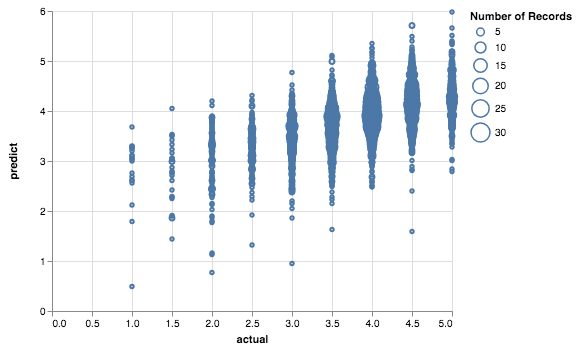

In [116]:
alt.Chart(comp_df.sample(5000)).mark_point().encode(x='actual:Q',y='predict:Q',size='count()')

## Exercise:  Can you improve this model?

Maybe we can make some improvement on our model if we get more creative than just a 0 or a 1 for each word, what if we used the frequency of the word? or what if we used the inverse of the frequency so that really common words have a lower score, but less frequently used words carry a bigger weight?

## Exercise: Use many fewer words, focus on words that only appear in either good reviews or bad reviews.

What are common words that are used to describe bad beers but not good beers?  What are words that are used to describe good beers but not bad beers?

### Exercise:  Use Good Beer Words and Bad Beer Words
